# ***2D Molecular dynamics simulation of Aragorn Fluid***

## *importing the packages, Configuration of the Figs and data directories*

In [154]:
include("Q1-MD.jl")
include("Q1-ExportData.jl")
using Plots, LaTeXStrings, Statistics, JLD, ProgressMeter, Plots.PlotMeasures
using StatsBase: autocor

figpath = "../../Figs/Q1/"
datapath = "../../Data/Q1/"
Plots.default(titlefontsize = 12, tickfontsize = 10, labelfontsize = 12, legendfontsize = 9,
    fontfamily = "Computer Modern", frame = :box, label = nothing, rightmargin = 3mm, bottommargin = 2mm)

### *Setting the Parameters and Exporting Data*

In [2]:
Parameters1 = Dict(:N => 100, :T₀ => 1.0, :h => 0.0015, :l => 50.0)
Parameters2 = Dict(:N => 100, :T₀ => 1.0, :h => 0.0005, :l => 50.0)

StepCount1 = 3000
Runnumver1 = 1000
StepCount2 = 200000


ExportData.AnsembleData(StepCount1, Runnumver1, Parameters1)
ExportData.SingleData(StepCount2, Parameters2)

Progress: 100%|█████████████████████████████████████████| Time: 13:04:31mmmmmm
Progress: 100%|█████████████████████████████████████████| Time: 13:04:32


### *Loading and Mining Data*

In [ ]:
TimeCollTD = collect(0:Parameters1[:h]:Parameters1[:h]*StepCount1)[1:StepCount1]
TimeCollSD = collect(0:Parameters2[:h]:Parameters2[:h]*StepCount2)[1:StepCount2]
DataTD = load(datapath * "DataTD.jld")
TotUColl = DataTD["TotUColl"]
TotKColl = DataTD["TotKColl"]
TotTColl = DataTD["TotTColl"]
TotPColl = DataTD["TotPColl"]
TotlsColl = DataTD["TotlsColl"]
TotrsColl = DataTD["TotrsColl"]
DataSD = load(datapath * "DataSD.jld")
PosColl = DataSD["PosColl"]
VelColl = DataSD["VelColl"]
UColl = DataSD["UColl"]
KColl = DataSD["KColl"]
TColl = DataSD["TColl"]
PColl = DataSD["PColl"]
ExportData.MineData(TotUColl, TotKColl, TotTColl, TotPColl, TotlsColl, TotrsColl)
MeanData = load(datapath * "MeanData.jld")
MeanUColl = MeanData["MEANUColl"]
MeanKColl = MeanData["MEANKColl"]
MeanTColl = MeanData["MEANTColl"]
MeanPColl = MeanData["MEANPColl"]
MeanlsColl = MeanData["MEANlsColl"]
MeanrsColl = MeanData["MEANrsColl"]
STDData = load(datapath * "STDData.jld")
STDUColl = STDData["STDUColl"]
STDKColl = STDData["STDKColl"]
STDTColl = STDData["STDTColl"]
STDPColl = STDData["STDPColl"]
STDlsColl = STDData["STDlsColl"]
STDrsColl = STDData["STDrsColl"]

## ***Properties of Single System***

### *Equlibrium*

In [156]:
plot(TimeCollSD, [count(<=(Parameters2[:l] / 2), PosColl[i, 1, :]) / Parameters2[:N] for i ∈ 1:StepCount2], c = :steelblue, label = "Particles on left")
plot!(TimeCollSD, [count(>(Parameters2[:l] / 2), PosColl[i, 1, :]) / Parameters2[:N] for i ∈ 1:StepCount2], c = :purple, label = "Particles on right")
plot!(title = "Particle density in the right and left halves\n" * L"N_{net}= %$(Parameters2[:N]),\ L_s= %$(Parameters2[:l]),\ \Delta{t}= %$(Parameters2[:h])" * "\n ",
    xlabel = "t/τ", ylabel = L"N_{left}/N_{net}", legend = :topright)

In [157]:
plot(TimeCollSD, UColl, c = :steelblue, label = "Potential Energy")
plot!(TimeCollSD, KColl, c = :purple, label = "Kinematic Energy")
plot!(TimeCollSD, UColl + KColl, c = :black, label = "Total Energy", lw = 2.5, legend = 0)
plot!(xlabel = "t/τ", ylabel = "E/ϵ", title = "Energy of system\n" * L"N_{net}= %$(Parameters2[:N]),\ L_s= %$(Parameters2[:l]),\ \Delta{t}= %$(Parameters2[:h])" * "\n ")

In [158]:
plot(TimeCollSD, 120 * TColl, c = :maroon, label = "Temperature")
plot!([0.0, 100.0], 120 * [mean(TColl[5000:end]), mean(TColl[5000:end])], c = :black, lw = 3,
    label = L"\langle T_{eq} \rangle = %$(round(mean(TColl[5000:end]), digits = 3))")
plot!(xlabel = "t/τ", ylabel = "T(K)", title = "Temperature of system\n" * L"N_{net}= %$(Parameters2[:N]),\ L_s= %$(Parameters2[:l]),\ \Delta{t}= %$(Parameters2[:h])" * "\n ")

In [159]:
plot(TimeCollSD, PColl, c = :purple4, label = "Pressure")
plot!([0.0, 100.0], [mean(PColl[5000:end]), mean(PColl[5000:end])], c = :black, lw = 3,
    label = L"\langle P_{eq} \rangle= %$(round(mean(PColl[5000:end]), digits = 3))")
plot!(xlabel = "t/τ", ylabel = L"P\sigma^2/\epsilon",
    title = "Pressure of system\n" * L"N_{net}= %$(Parameters2[:N]),\ L_s= %$(Parameters2[:l]),\ \Delta{t}= %$(Parameters2[:h])" * "\n ")

### *Autocorrelation of velocity*

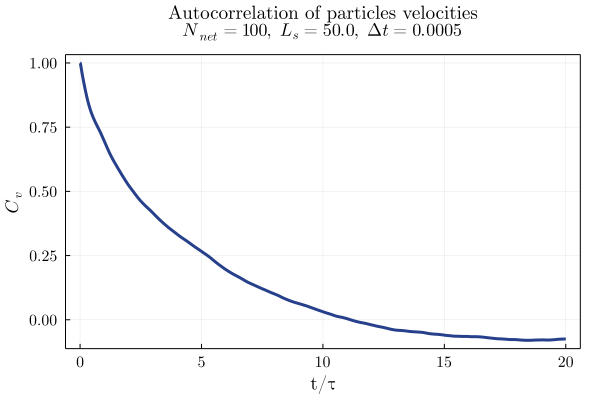

In [166]:
# v = Matrix{Float64}(undef, StepCount2, Parameters2[:N])
# for i in 1:StepCount2
#     v[i, :] = @. √(VelColl[i, 1, :]^2 + VelColl[i, 2, :]^2)
# end

# autocorrelation = autocor(v, 1:StepCount2÷5)
plot(TimeCollSD[1:StepCount2÷5], mean(autocorrelation, dims = 2), c = :royalblue4, lw = 3)
plot!(xlabel = "t/τ", ylabel = L"C_v",
    title = "Autocorrelation of particles velocities\n" * L"N_{net}= %$(Parameters2[:N]),\ L_s= %$(Parameters2[:l]),\ \Delta{t}= %$(Parameters2[:h])" * "\n ")

## ***Average of Properties of System on thousand runs***

### *Equlibrium*

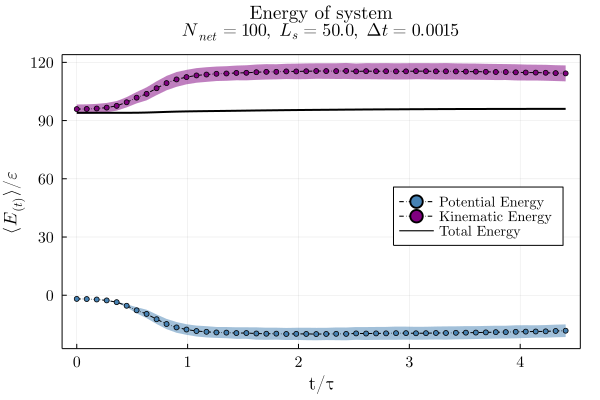

In [133]:
plot(TimeCollTD[1:60:end], MeanUColl[1:60:end], ribbon = STDUColl[1:60:end],
    ls = :dashdot, lc = :black, c = :steelblue, m = :c, mc = :steelblue, ms = 3, label = "Potential Energy")
plot!(TimeCollTD[1:60:end], MeanKColl[1:60:end], ribbon = STDKColl[1:60:end],
    ls = :dashdot, lc = :black, c = :purple, m = :c, mc = :purple, ms = 3, label = "Kinematic Energy")
plot!(TimeCollTD[1:60:end], MeanUColl[1:60:end] + MeanKColl[1:60:end],
    ls = :solid, lc = :black, lw = 2, label = "Total Energy", legend = 0)
plot!(xlabel = "t/τ", ylabel = L"\langle E_{(t)} \rangle/\epsilon",
    title = "Energy of system\n" * L"N_{net}= %$(Parameters1[:N]),\ L_s= %$(Parameters1[:l]),\ \Delta{t}= %$(Parameters1[:h])" * "\n ")

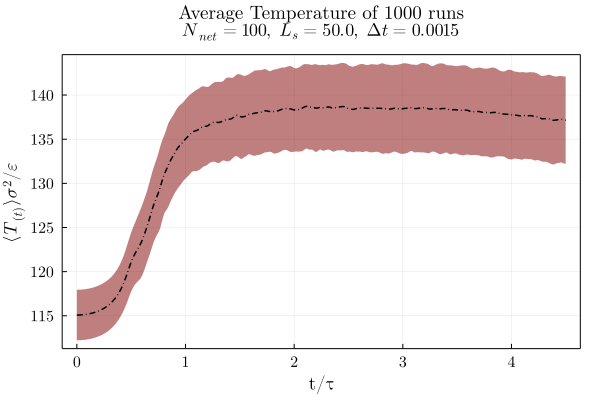

In [131]:
plot(TimeCollTD, 120 * MeanTColl, ribbon = 120 * STDTColl, c = :maroon, ls = :dashdot, lc = :black, lw = 1.5)
plot!(xlabel = "t/τ", ylabel = L"\langle T_{(t)} \rangle\sigma^2/\epsilon",
    title = "Average Temperature on 1000 runs\n" * L"N_{net}= %$(Parameters1[:N]),\ L_s= %$(Parameters1[:l]),\ \Delta{t}= %$(Parameters1[:h])" * "\n ")

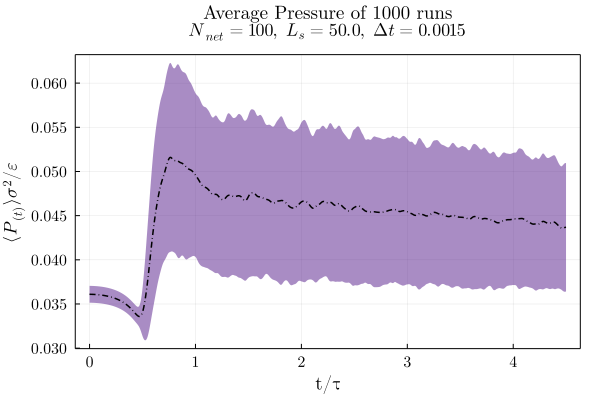

In [123]:
plot(TimeCollTD, MeanPColl, ribbon = STDPColl, c = :purple4, ls = :dashdot, lc = :black, lw = 1.5)
plot!(xlabel = "t/τ", ylabel = L"\langle P_{(t)} \rangle\sigma^2/\epsilon",
    title = "Average Pressure on 1000 runs\n" * L"N_{net}= %$(Parameters1[:N]),\ L_s= %$(Parameters1[:l]),\ \Delta{t}= %$(Parameters1[:h])" * "\n ")

In [ ]:
# plot()
# for i ∈ [collect(20:24); collect(28:35)]
#     plot!(PosColl[:, 1, i], PosColl[:, 2, i])
# end
# plot!()


# save(datapath * "Data1.jld",
#     "PosColl", PosColl, "VelColl", VelColl,
#     "UColl", UColl, "KColl", KColl, "TColl", TColl, "PColl", PColl)

# # scatter([Tuple(sys.r[:, n]) for n ∈ 1:sys.N], xlims = (-1, 30.0), ylims = (-1, 30.0))